fine-tuning a pretrained object detection model

following tutorial: [fine-tuning pre-triained models](https://docs.pytorch.org/tutorials/intermediate/torchvision_tutorial.html)

train dataset is [1,2,3,4,5,6,7] android images
test dataset is video snapshots of android statues

In [1]:
import load_statues
import load_pytorch_models
import os
import sys
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
import torch
from torch.utils.data import Dataset
from torchvision import tv_tensors
from torchvision.tv_tensors import BoundingBoxFormat
from torchvision.utils import draw_bounding_boxes, draw_segmentation_masks
from torchvision.io import read_image
from torchvision.ops.boxes import masks_to_boxes
from torchvision.transforms.v2 import functional as F


#add 1 to number of classes to preserve class 0, but constraints of the pretrained model
num_classes_custom = len(load_statues.class_mapping)  + 1 #9
print(f'num_classes_custom={num_classes_custom}')

num_classes_custom=10


In [2]:
model = load_pytorch_models.get_faster_rcnn(num_classes_custom)

in_features=1024


In [3]:
#model2 = load_pytorch_models.get_faster_rcnn_with_masks(num_classes_custom)

In [4]:
#putting these in bin... change as needed
module_dir = os.path.join(os.getcwd(), '..', 'bin')
sys.path.append(module_dir)
if not os.path.exists(os.path.join(module_dir, "utils.py")):
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py" -o ../bin/engine.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py" -o ../bin/utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py" -o ../bin/coco_utils.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py" -o ../bin/coco_eval.py
    !curl -L "https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py" -o ../bin/transforms.py

import utils
from torch.utils.data import Subset
from sklearn.model_selection import train_test_split

category_index, dataset, dataset_test = load_statues.load_statues(\
    load_pytorch_models.get_transform(train=True))

#split dataset into train and validation
def train_val_dataset(dataset, val_split=0.25):
    train_idx, val_idx = train_test_split(list(range(len(dataset))), test_size=val_split)
    return Subset(dataset, train_idx), Subset(dataset, val_idx)

dataset_train, dataset_val = train_val_dataset(dataset)

print(f'load data')
data_loader_train = torch.utils.data.DataLoader(dataset_train,\
    batch_size=1,
    shuffle=False,
    collate_fn=utils.collate_fn)

data_loader_val = torch.utils.data.DataLoader(dataset_val,\
    batch_size=1,
    shuffle=False,
    collate_fn=utils.collate_fn)

if True:
    print(f'check inputs accepted by model')
    _images, _targets = next(iter(data_loader_train))
    _images = list(image for image in _images)
    _targets = [{k: v for k, v in t.items()} for t in _targets]
    output = model(_images, _targets)  # Returns losses and detections
    print(output)

from engine import train_one_epoch, evaluate

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)


load data
check inputs accepted by model
{'loss_classifier': tensor(2.1634, grad_fn=<NllLossBackward0>), 'loss_box_reg': tensor(0.1467, grad_fn=<DivBackward0>), 'loss_objectness': tensor(0.0666), 'loss_rpn_box_reg': tensor(0.0035)}


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

install the video software and sample some frames from the video

In [5]:
#load video frames to use in test
filepaths = load_statues.get_video_snapshot_filepaths()


have already downloaded YouTube mp4 file


run pre-trained model on test data
labels[0]=['4: 0.255', '4: 0.250', '4: 0.244', '4: 0.230', '4: 0.219', '2: 0.216', '4: 0.212', '2: 0.211', '2: 0.208', '4: 0.207', '7: 0.207', '4: 0.207', '2: 0.206', '4: 0.206', '4: 0.206', '5: 0.205', '1: 0.204', '4: 0.203', '5: 0.203', '4: 0.203', '8: 0.203', '4: 0.202', '4: 0.200', '5: 0.199', '4: 0.197', '1: 0.196', '6: 0.195', '8: 0.193', '8: 0.193', '1: 0.193', '1: 0.192', '4: 0.191', '8: 0.191', '4: 0.190', '2: 0.190', '4: 0.189', '5: 0.189', '1: 0.189', '5: 0.189', '1: 0.189', '6: 0.187', '6: 0.186', '8: 0.186', '1: 0.185', '4: 0.184', '5: 0.184', '8: 0.184', '4: 0.182', '1: 0.181', '2: 0.181', '6: 0.181', '4: 0.181', '4: 0.180', '3: 0.180', '4: 0.179', '4: 0.179', '8: 0.179', '5: 0.179', '5: 0.179', '6: 0.178', '4: 0.178', '4: 0.177', '2: 0.177', '1: 0.177', '4: 0.176', '4: 0.176', '4: 0.176', '4: 0.176', '4: 0.175', '5: 0.175', '4: 0.175', '4: 0.175', '8: 0.174', '4: 0.174', '1: 0.174', '4: 0.174', '4: 0.174', '8: 0.173', '8: 0.173', '3: 0.

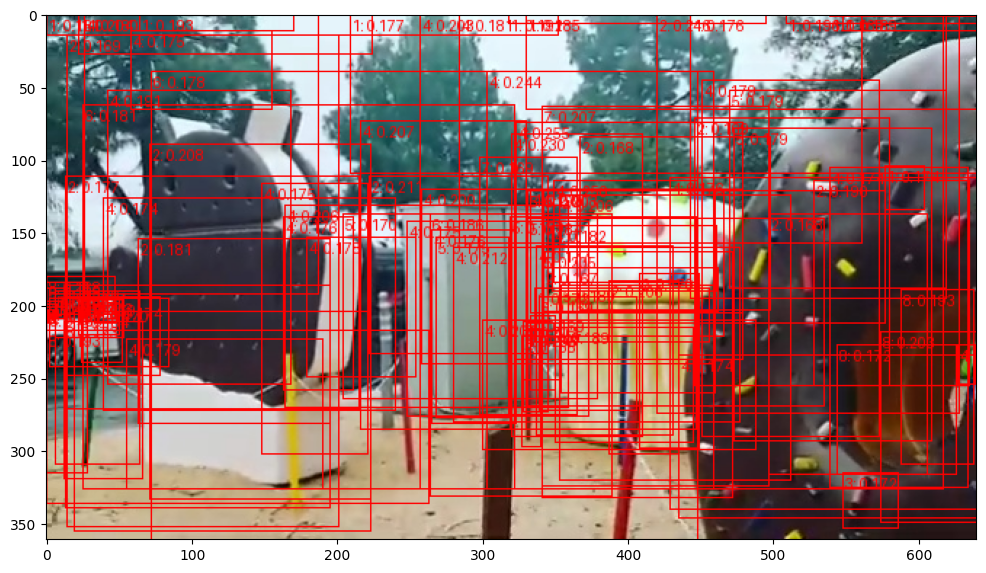

labels[1]=['4: 0.231', '4: 0.227', '4: 0.226', '4: 0.216', '4: 0.216', '4: 0.216', '5: 0.207', '4: 0.204', '4: 0.203', '4: 0.201', '2: 0.195', '4: 0.193', '4: 0.191', '4: 0.191', '2: 0.190', '5: 0.190', '4: 0.189', '4: 0.188', '4: 0.188', '6: 0.187', '4: 0.187', '4: 0.186', '8: 0.185', '6: 0.184', '4: 0.184', '8: 0.184', '4: 0.183', '4: 0.182', '1: 0.182', '4: 0.182', '4: 0.181', '4: 0.181', '1: 0.180', '2: 0.180', '3: 0.180', '1: 0.179', '1: 0.179', '1: 0.179', '1: 0.179', '1: 0.179', '4: 0.179', '6: 0.179', '1: 0.178', '2: 0.178', '3: 0.177', '1: 0.176', '1: 0.175', '4: 0.175', '4: 0.175', '6: 0.175', '2: 0.175', '1: 0.174', '1: 0.174', '1: 0.174', '4: 0.174', '2: 0.174', '1: 0.173', '2: 0.173', '1: 0.173', '4: 0.173', '7: 0.173', '5: 0.173', '8: 0.172', '8: 0.172', '1: 0.172', '1: 0.172', '4: 0.172', '4: 0.171', '8: 0.171', '8: 0.170', '3: 0.170', '2: 0.169', '4: 0.169', '1: 0.169', '5: 0.169', '4: 0.169', '6: 0.169', '5: 0.168', '6: 0.168', '4: 0.168', '1: 0.168', '4: 0.168', '2: 0

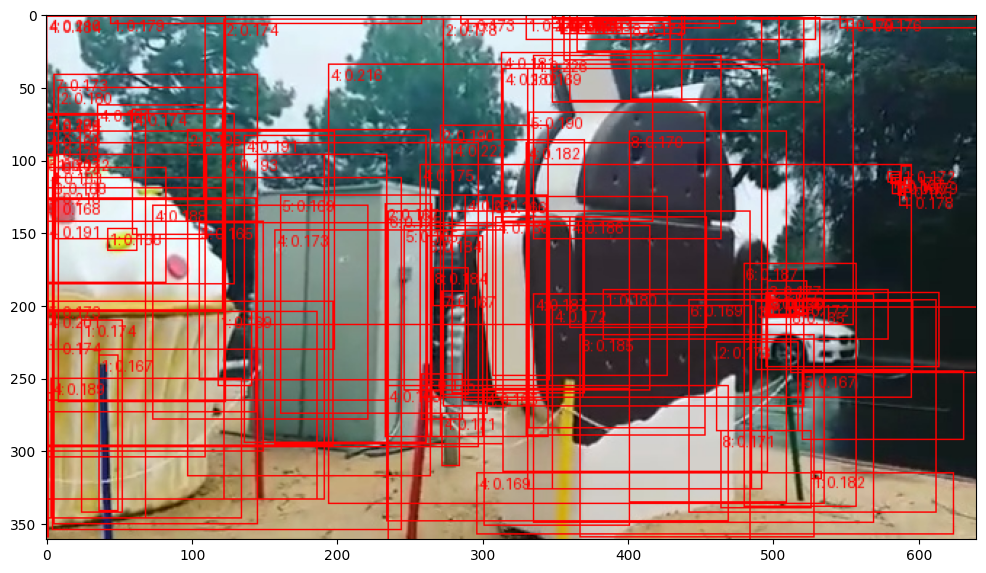

labels[2]=['4: 0.248', '8: 0.215', '4: 0.210', '4: 0.209', '4: 0.208', '4: 0.206', '4: 0.206', '2: 0.206', '2: 0.205', '4: 0.205', '2: 0.202', '4: 0.201', '2: 0.200', '2: 0.200', '4: 0.197', '6: 0.197', '8: 0.195', '2: 0.193', '4: 0.193', '8: 0.192', '1: 0.190', '5: 0.187', '2: 0.187', '4: 0.187', '4: 0.187', '1: 0.185', '4: 0.185', '6: 0.185', '5: 0.184', '6: 0.183', '8: 0.183', '5: 0.183', '1: 0.182', '8: 0.182', '4: 0.181', '2: 0.181', '8: 0.181', '4: 0.180', '6: 0.180', '4: 0.180', '5: 0.180', '1: 0.180', '4: 0.179', '1: 0.177', '8: 0.177', '1: 0.177', '5: 0.176', '1: 0.176', '1: 0.176', '2: 0.175', '4: 0.175', '2: 0.175', '7: 0.175', '2: 0.175', '4: 0.174', '1: 0.174', '5: 0.174', '8: 0.174', '8: 0.174', '8: 0.173', '2: 0.172', '5: 0.172', '1: 0.172', '8: 0.172', '1: 0.172', '6: 0.172', '2: 0.172', '2: 0.171', '6: 0.171', '1: 0.171', '2: 0.171', '1: 0.171', '1: 0.170', '2: 0.170', '1: 0.170', '4: 0.170', '8: 0.169', '8: 0.169', '1: 0.169', '6: 0.168', '4: 0.168', '6: 0.168', '5: 0

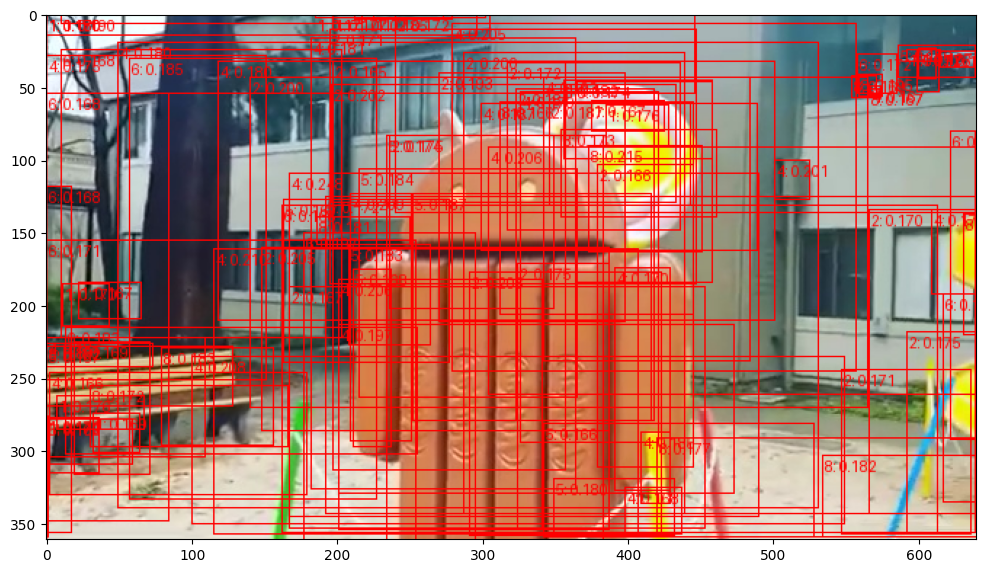

labels[3]=['4: 0.281', '2: 0.261', '4: 0.248', '2: 0.238', '4: 0.233', '4: 0.225', '5: 0.224', '2: 0.222', '2: 0.221', '1: 0.220', '4: 0.216', '4: 0.216', '4: 0.215', '4: 0.214', '5: 0.214', '1: 0.213', '5: 0.208', '2: 0.207', '2: 0.207', '4: 0.203', '2: 0.202', '4: 0.198', '5: 0.198', '1: 0.197', '4: 0.197', '2: 0.196', '1: 0.196', '4: 0.196', '4: 0.196', '4: 0.195', '1: 0.194', '4: 0.194', '4: 0.193', '2: 0.193', '4: 0.193', '8: 0.192', '8: 0.191', '8: 0.191', '1: 0.191', '2: 0.190', '1: 0.190', '2: 0.190', '5: 0.190', '4: 0.190', '8: 0.189', '4: 0.189', '2: 0.188', '1: 0.188', '2: 0.188', '5: 0.188', '4: 0.188', '5: 0.187', '4: 0.187', '2: 0.186', '1: 0.186', '4: 0.186', '1: 0.185', '4: 0.184', '2: 0.184', '1: 0.184', '1: 0.184', '2: 0.182', '4: 0.182', '5: 0.181', '4: 0.181', '4: 0.181', '8: 0.180', '4: 0.180', '4: 0.180', '1: 0.179', '8: 0.179', '1: 0.179', '1: 0.179', '4: 0.178', '8: 0.178', '4: 0.178', '2: 0.178', '1: 0.178', '1: 0.177', '1: 0.177', '8: 0.177', '1: 0.177', '2: 0

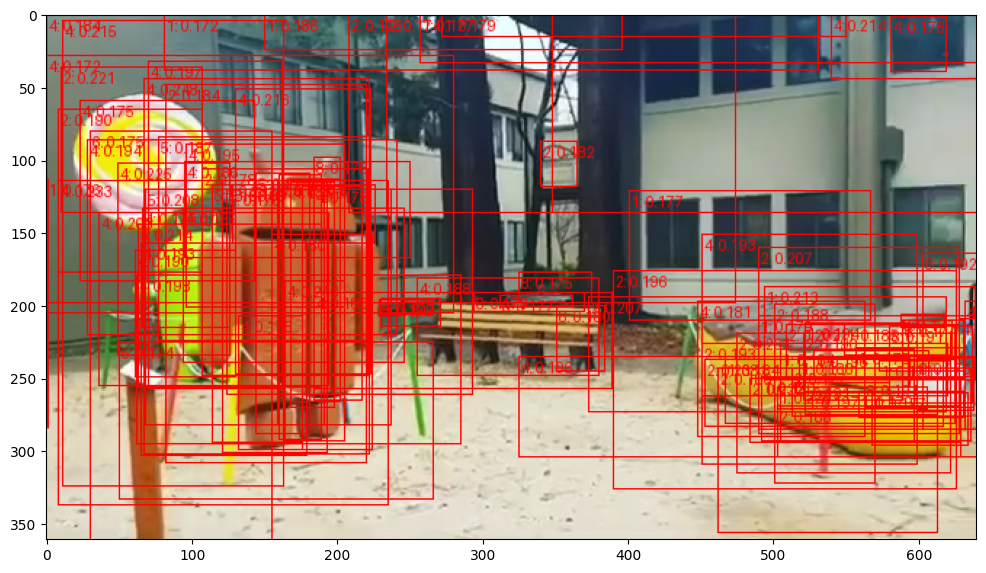

labels[4]=['2: 0.248', '2: 0.244', '2: 0.237', '2: 0.235', '2: 0.232', '2: 0.227', '8: 0.216', '2: 0.211', '2: 0.210', '4: 0.208', '2: 0.207', '8: 0.205', '4: 0.201', '2: 0.199', '8: 0.199', '1: 0.199', '1: 0.196', '2: 0.195', '5: 0.194', '4: 0.193', '2: 0.191', '2: 0.190', '7: 0.190', '1: 0.190', '1: 0.189', '2: 0.188', '1: 0.187', '1: 0.185', '1: 0.184', '8: 0.184', '8: 0.184', '4: 0.184', '1: 0.183', '1: 0.183', '5: 0.182', '4: 0.182', '2: 0.182', '1: 0.182', '1: 0.181', '1: 0.180', '4: 0.180', '2: 0.180', '4: 0.180', '1: 0.179', '1: 0.179', '1: 0.178', '2: 0.177', '8: 0.176', '6: 0.174', '1: 0.174', '1: 0.174', '1: 0.174', '1: 0.173', '1: 0.173', '2: 0.173', '1: 0.173', '2: 0.172', '2: 0.172', '1: 0.172', '1: 0.171', '8: 0.171', '4: 0.171', '2: 0.171', '1: 0.170', '1: 0.170', '8: 0.170', '1: 0.169', '8: 0.169', '1: 0.169', '5: 0.169', '1: 0.169', '2: 0.169', '6: 0.169', '1: 0.168', '8: 0.168', '2: 0.168', '2: 0.167', '1: 0.167', '2: 0.167', '8: 0.167', '2: 0.166', '2: 0.166', '1: 0

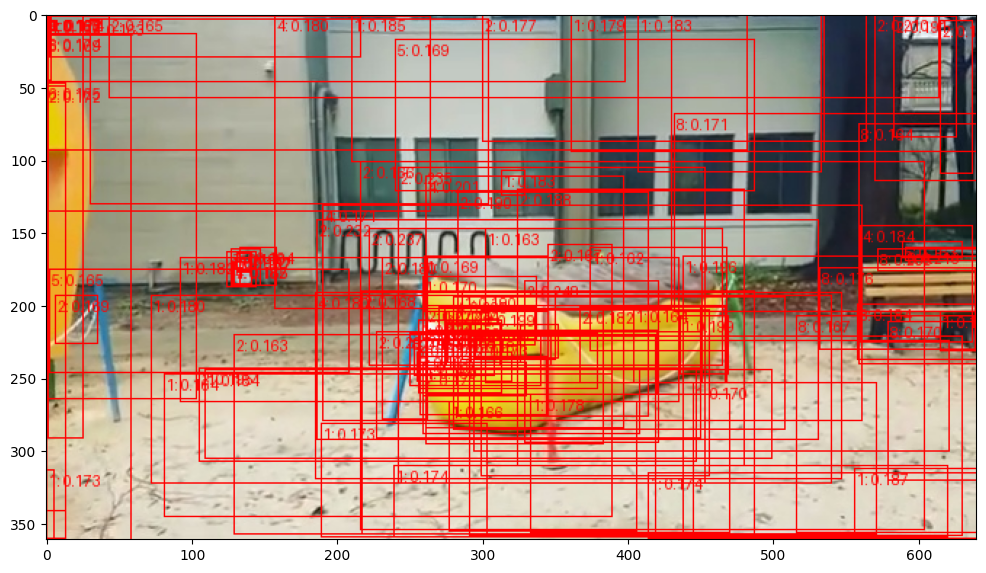

labels[5]=['4: 0.246', '4: 0.236', '1: 0.215', '1: 0.210', '2: 0.208', '4: 0.208', '8: 0.207', '4: 0.207', '4: 0.203', '4: 0.203', '4: 0.202', '4: 0.200', '4: 0.199', '4: 0.198', '4: 0.198', '1: 0.196', '2: 0.196', '2: 0.195', '4: 0.195', '4: 0.194', '4: 0.194', '4: 0.194', '1: 0.193', '2: 0.193', '8: 0.192', '4: 0.189', '4: 0.189', '4: 0.188', '4: 0.188', '4: 0.188', '1: 0.187', '4: 0.186', '4: 0.186', '8: 0.185', '4: 0.185', '4: 0.184', '8: 0.184', '4: 0.184', '4: 0.184', '4: 0.184', '4: 0.183', '3: 0.183', '1: 0.183', '4: 0.183', '8: 0.183', '4: 0.182', '4: 0.182', '3: 0.182', '5: 0.181', '2: 0.181', '1: 0.181', '2: 0.181', '4: 0.180', '1: 0.180', '8: 0.180', '4: 0.180', '2: 0.180', '2: 0.179', '1: 0.178', '2: 0.178', '4: 0.178', '2: 0.178', '4: 0.178', '4: 0.177', '1: 0.176', '4: 0.176', '2: 0.176', '4: 0.175', '1: 0.175', '2: 0.175', '1: 0.175', '1: 0.174', '4: 0.174', '2: 0.174', '3: 0.174', '2: 0.174', '4: 0.174', '1: 0.173', '1: 0.173', '2: 0.172', '1: 0.172', '3: 0.172', '1: 0

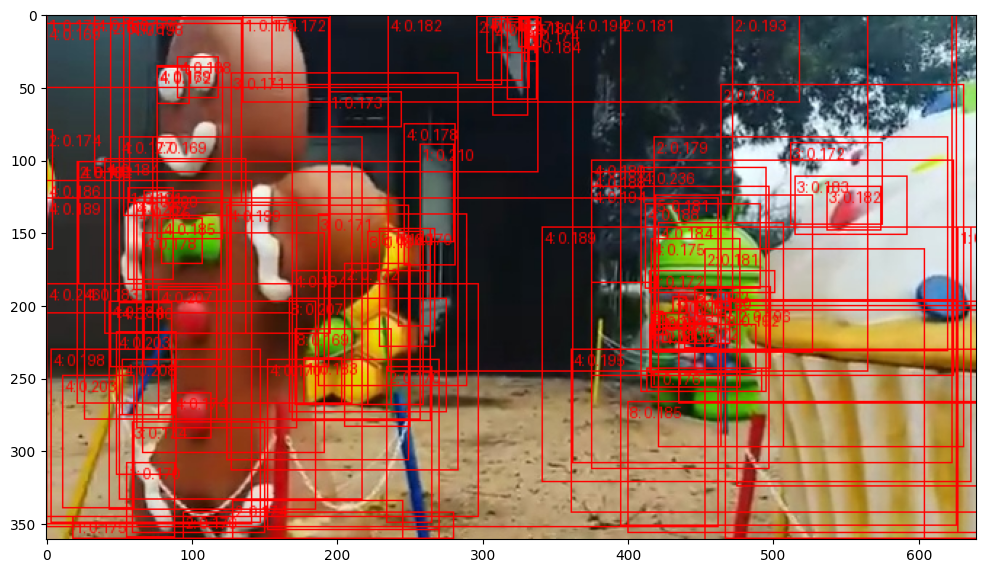

labels[6]=['4: 0.225', '4: 0.219', '4: 0.216', '4: 0.215', '4: 0.213', '4: 0.210', '4: 0.209', '2: 0.206', '1: 0.204', '5: 0.203', '4: 0.201', '4: 0.200', '4: 0.199', '1: 0.198', '8: 0.196', '4: 0.194', '4: 0.193', '4: 0.192', '5: 0.192', '8: 0.192', '4: 0.192', '4: 0.191', '5: 0.189', '5: 0.189', '1: 0.189', '4: 0.189', '4: 0.188', '5: 0.188', '8: 0.187', '1: 0.187', '4: 0.187', '4: 0.185', '5: 0.185', '5: 0.184', '2: 0.184', '1: 0.184', '8: 0.183', '4: 0.183', '2: 0.183', '5: 0.183', '1: 0.182', '4: 0.182', '1: 0.182', '4: 0.181', '4: 0.181', '4: 0.181', '4: 0.181', '6: 0.180', '2: 0.179', '8: 0.179', '1: 0.179', '8: 0.179', '1: 0.179', '8: 0.178', '1: 0.178', '1: 0.177', '1: 0.177', '6: 0.176', '2: 0.175', '8: 0.175', '4: 0.175', '1: 0.175', '1: 0.175', '1: 0.174', '5: 0.173', '4: 0.173', '1: 0.173', '1: 0.172', '6: 0.172', '5: 0.172', '4: 0.172', '4: 0.172', '4: 0.172', '4: 0.171', '2: 0.171', '6: 0.171', '4: 0.171', '2: 0.171', '4: 0.170', '8: 0.170', '1: 0.170', '2: 0.170', '4: 0

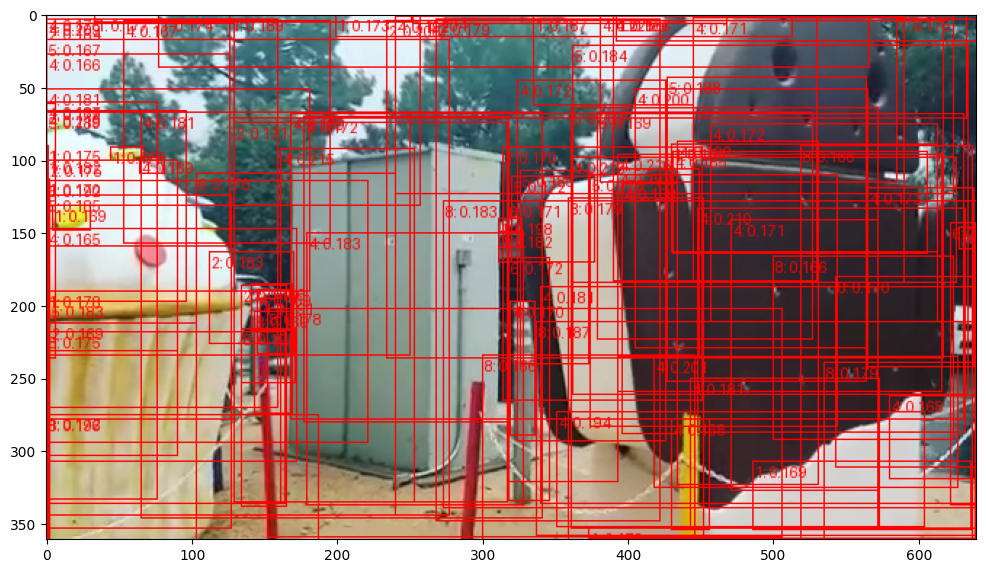

labels[7]=['4: 0.308', '4: 0.249', '3: 0.237', '1: 0.235', '5: 0.229', '4: 0.225', '3: 0.223', '8: 0.222', '4: 0.218', '4: 0.217', '4: 0.216', '5: 0.212', '5: 0.211', '1: 0.210', '4: 0.209', '4: 0.207', '4: 0.206', '8: 0.205', '4: 0.201', '1: 0.200', '4: 0.198', '8: 0.196', '4: 0.196', '5: 0.196', '6: 0.195', '1: 0.195', '2: 0.194', '8: 0.192', '3: 0.192', '4: 0.191', '5: 0.191', '1: 0.191', '1: 0.191', '1: 0.190', '8: 0.190', '4: 0.189', '4: 0.189', '3: 0.189', '4: 0.188', '1: 0.188', '4: 0.188', '3: 0.187', '4: 0.186', '2: 0.186', '1: 0.185', '2: 0.184', '1: 0.184', '8: 0.184', '1: 0.184', '4: 0.184', '8: 0.183', '5: 0.182', '5: 0.181', '1: 0.181', '1: 0.181', '2: 0.181', '6: 0.181', '1: 0.180', '1: 0.180', '4: 0.179', '1: 0.179', '4: 0.179', '5: 0.179', '5: 0.179', '4: 0.179', '1: 0.179', '4: 0.179', '4: 0.178', '8: 0.177', '4: 0.177', '1: 0.177', '8: 0.177', '1: 0.177', '2: 0.176', '1: 0.175', '2: 0.174', '1: 0.174', '8: 0.174', '1: 0.173', '2: 0.173', '2: 0.173', '5: 0.172', '1: 0

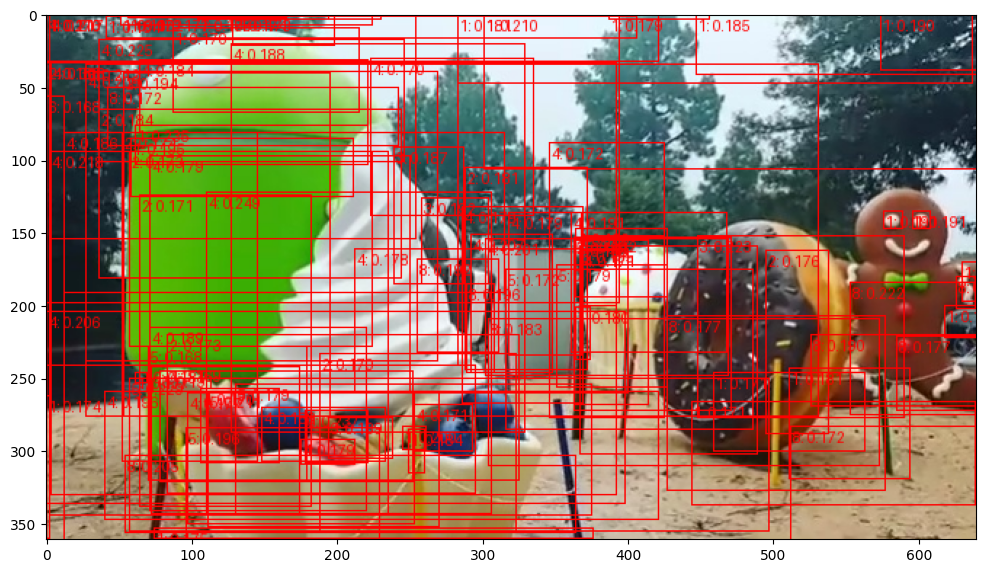

labels[8]=['2: 0.271', '1: 0.231', '1: 0.227', '4: 0.224', '2: 0.222', '1: 0.219', '2: 0.215', '3: 0.214', '1: 0.213', '4: 0.211', '8: 0.207', '1: 0.207', '2: 0.207', '1: 0.206', '4: 0.206', '3: 0.205', '1: 0.204', '1: 0.204', '1: 0.203', '8: 0.202', '5: 0.201', '4: 0.199', '3: 0.199', '2: 0.198', '1: 0.198', '5: 0.197', '1: 0.197', '4: 0.195', '1: 0.195', '8: 0.194', '1: 0.194', '4: 0.194', '2: 0.191', '1: 0.191', '1: 0.191', '2: 0.188', '4: 0.187', '8: 0.187', '3: 0.187', '2: 0.186', '8: 0.185', '1: 0.184', '1: 0.184', '1: 0.184', '4: 0.184', '2: 0.184', '1: 0.184', '2: 0.183', '1: 0.183', '1: 0.183', '4: 0.182', '4: 0.182', '4: 0.182', '1: 0.181', '1: 0.180', '4: 0.180', '1: 0.179', '8: 0.179', '2: 0.179', '8: 0.178', '1: 0.178', '5: 0.178', '1: 0.178', '1: 0.177', '8: 0.177', '2: 0.177', '8: 0.177', '8: 0.176', '4: 0.176', '4: 0.176', '4: 0.176', '4: 0.176', '5: 0.175', '8: 0.175', '1: 0.175', '8: 0.174', '2: 0.174', '5: 0.173', '1: 0.173', '2: 0.173', '8: 0.173', '8: 0.173', '2: 0

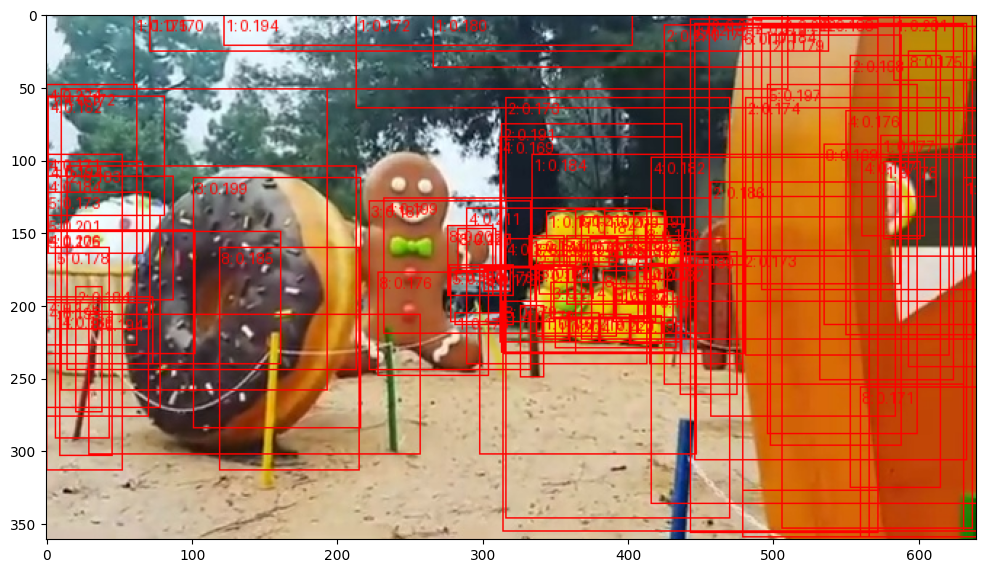

labels[9]=['5: 0.238', '2: 0.234', '4: 0.233', '1: 0.227', '1: 0.226', '2: 0.225', '1: 0.220', '1: 0.217', '1: 0.215', '2: 0.211', '1: 0.211', '2: 0.209', '1: 0.209', '4: 0.208', '4: 0.207', '4: 0.207', '1: 0.206', '4: 0.206', '4: 0.204', '1: 0.203', '1: 0.200', '1: 0.199', '4: 0.198', '8: 0.197', '2: 0.197', '1: 0.196', '4: 0.195', '1: 0.194', '2: 0.194', '1: 0.193', '2: 0.192', '2: 0.191', '8: 0.190', '5: 0.190', '4: 0.189', '1: 0.188', '1: 0.187', '1: 0.187', '1: 0.187', '1: 0.186', '4: 0.186', '4: 0.185', '6: 0.185', '2: 0.184', '1: 0.184', '4: 0.183', '4: 0.183', '4: 0.183', '4: 0.182', '3: 0.182', '1: 0.182', '4: 0.181', '1: 0.181', '2: 0.180', '1: 0.180', '3: 0.180', '1: 0.180', '1: 0.180', '8: 0.180', '2: 0.180', '3: 0.180', '6: 0.179', '1: 0.178', '2: 0.177', '1: 0.177', '2: 0.177', '2: 0.177', '4: 0.177', '1: 0.176', '1: 0.176', '1: 0.176', '2: 0.176', '1: 0.176', '1: 0.175', '1: 0.175', '5: 0.175', '4: 0.175', '4: 0.174', '4: 0.174', '2: 0.173', '4: 0.172', '4: 0.172', '4: 0

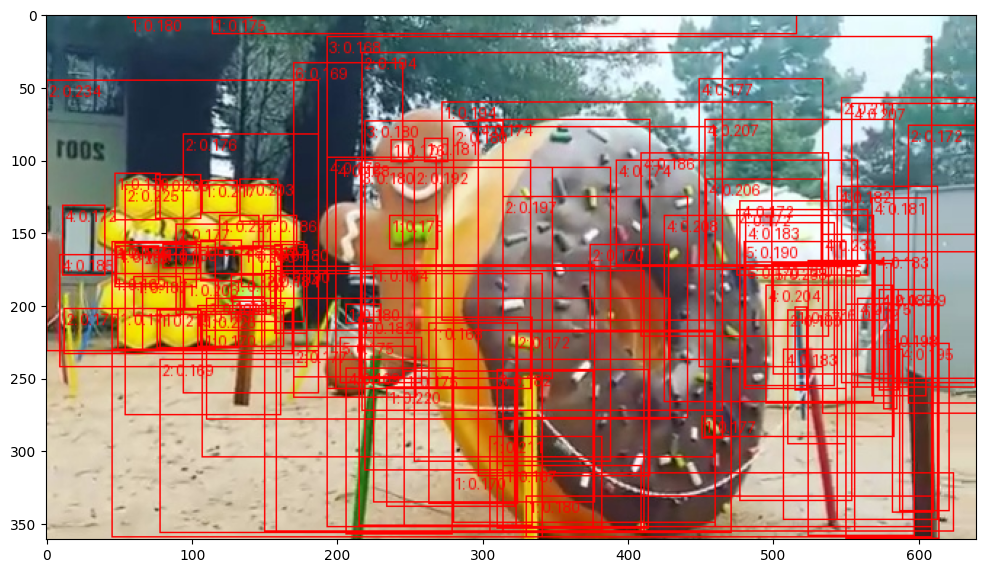

labels[10]=['1: 0.227', '4: 0.220', '1: 0.220', '4: 0.218', '4: 0.215', '4: 0.208', '1: 0.208', '1: 0.200', '2: 0.199', '1: 0.198', '1: 0.198', '5: 0.197', '1: 0.197', '1: 0.196', '1: 0.196', '8: 0.196', '5: 0.196', '4: 0.195', '1: 0.195', '2: 0.194', '2: 0.194', '2: 0.194', '1: 0.192', '5: 0.191', '6: 0.191', '1: 0.191', '2: 0.190', '1: 0.190', '1: 0.190', '6: 0.189', '5: 0.189', '1: 0.188', '5: 0.187', '8: 0.186', '1: 0.186', '4: 0.185', '1: 0.185', '1: 0.185', '1: 0.184', '6: 0.184', '1: 0.183', '5: 0.183', '1: 0.183', '7: 0.182', '2: 0.182', '1: 0.182', '4: 0.182', '2: 0.182', '5: 0.181', '2: 0.181', '4: 0.181', '8: 0.180', '1: 0.179', '8: 0.179', '1: 0.179', '1: 0.179', '6: 0.177', '4: 0.177', '4: 0.177', '4: 0.177', '2: 0.177', '1: 0.176', '1: 0.175', '1: 0.175', '1: 0.175', '1: 0.175', '1: 0.175', '8: 0.174', '1: 0.174', '1: 0.173', '2: 0.173', '1: 0.173', '5: 0.172', '4: 0.172', '1: 0.172', '2: 0.171', '1: 0.171', '1: 0.171', '2: 0.171', '6: 0.170', '5: 0.170', '1: 0.170', '4: 

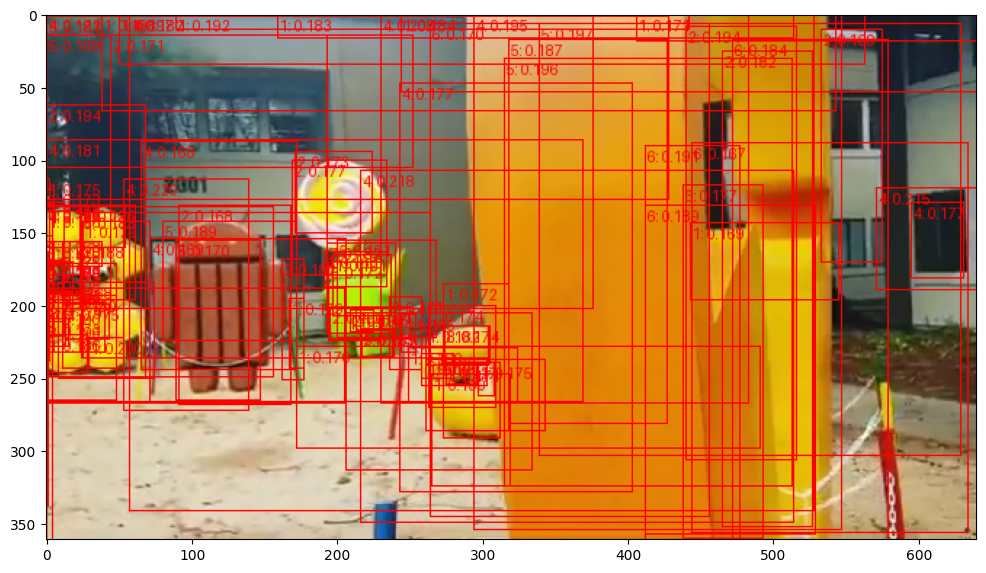

labels[11]=['4: 0.281', '4: 0.247', '2: 0.222', '2: 0.221', '4: 0.216', '4: 0.215', '1: 0.212', '1: 0.211', '4: 0.208', '1: 0.208', '4: 0.207', '8: 0.205', '2: 0.205', '1: 0.205', '2: 0.205', '1: 0.203', '8: 0.202', '5: 0.202', '1: 0.201', '4: 0.200', '4: 0.199', '2: 0.197', '1: 0.197', '2: 0.195', '1: 0.195', '6: 0.194', '2: 0.194', '2: 0.192', '4: 0.192', '1: 0.191', '4: 0.191', '1: 0.190', '2: 0.189', '4: 0.188', '1: 0.188', '1: 0.188', '1: 0.187', '1: 0.187', '6: 0.186', '4: 0.185', '8: 0.185', '5: 0.184', '4: 0.183', '4: 0.183', '1: 0.183', '1: 0.182', '2: 0.182', '7: 0.181', '2: 0.181', '5: 0.181', '1: 0.181', '1: 0.181', '4: 0.180', '1: 0.180', '5: 0.180', '8: 0.180', '4: 0.180', '2: 0.180', '4: 0.179', '4: 0.178', '1: 0.178', '8: 0.178', '5: 0.177', '4: 0.177', '5: 0.177', '1: 0.177', '4: 0.177', '2: 0.177', '4: 0.176', '8: 0.176', '1: 0.176', '4: 0.175', '4: 0.175', '2: 0.175', '5: 0.174', '1: 0.174', '6: 0.174', '1: 0.173', '2: 0.173', '1: 0.173', '8: 0.173', '5: 0.173', '1: 

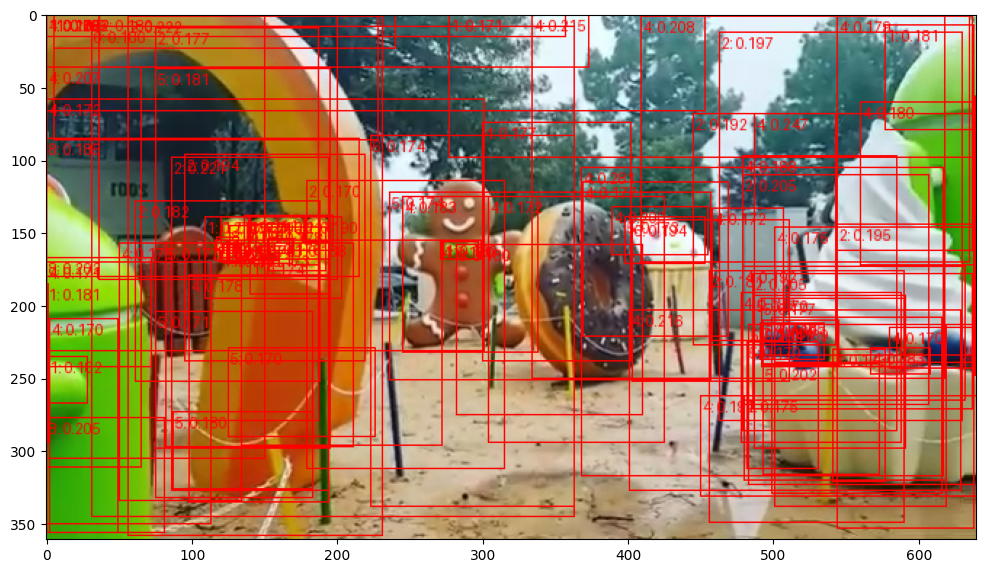

labels[12]=['4: 0.289', '4: 0.251', '4: 0.241', '4: 0.241', '4: 0.237', '4: 0.232', '2: 0.231', '6: 0.221', '4: 0.217', '2: 0.209', '4: 0.207', '2: 0.206', '1: 0.206', '1: 0.205', '4: 0.201', '4: 0.201', '4: 0.201', '4: 0.199', '5: 0.198', '2: 0.198', '1: 0.196', '1: 0.196', '1: 0.194', '6: 0.194', '8: 0.194', '1: 0.192', '8: 0.191', '1: 0.191', '5: 0.191', '2: 0.190', '4: 0.190', '1: 0.190', '7: 0.189', '2: 0.189', '5: 0.187', '8: 0.186', '1: 0.185', '5: 0.185', '8: 0.184', '4: 0.184', '4: 0.184', '8: 0.183', '2: 0.183', '1: 0.183', '4: 0.182', '1: 0.181', '1: 0.181', '5: 0.180', '1: 0.180', '8: 0.179', '4: 0.178', '2: 0.177', '1: 0.177', '4: 0.177', '1: 0.177', '5: 0.176', '4: 0.176', '2: 0.176', '4: 0.176', '8: 0.176', '6: 0.175', '3: 0.175', '8: 0.175', '4: 0.175', '4: 0.174', '2: 0.174', '1: 0.174', '1: 0.173', '1: 0.173', '2: 0.173', '3: 0.172', '8: 0.172', '6: 0.172', '4: 0.171', '4: 0.171', '3: 0.171', '7: 0.171', '8: 0.171', '5: 0.170', '1: 0.170', '1: 0.170', '8: 0.170', '1: 

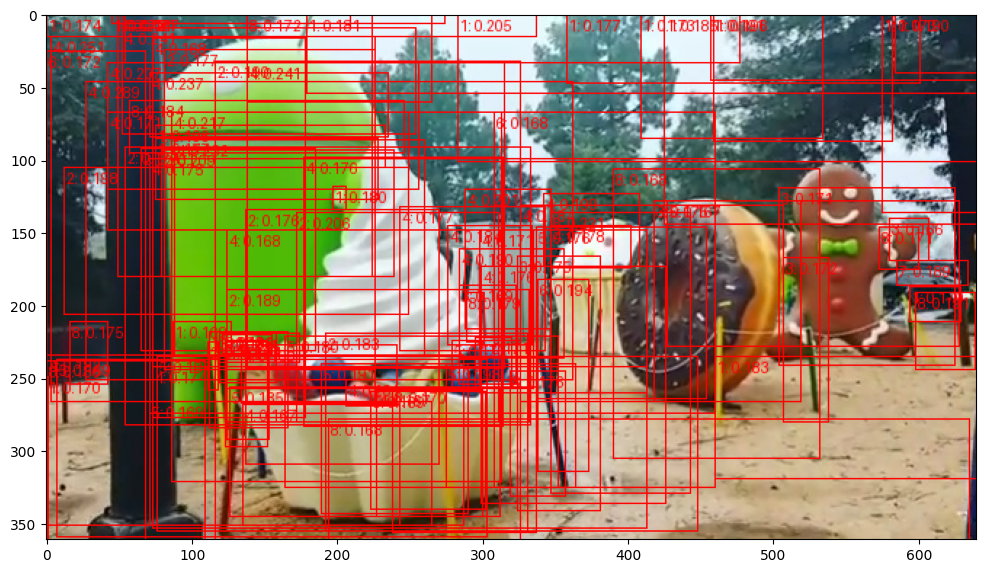

labels[13]=['4: 0.343', '4: 0.301', '4: 0.252', '2: 0.239', '2: 0.235', '4: 0.235', '2: 0.234', '2: 0.233', '1: 0.230', '4: 0.224', '4: 0.224', '8: 0.222', '2: 0.221', '2: 0.218', '1: 0.215', '4: 0.214', '8: 0.211', '4: 0.211', '8: 0.210', '2: 0.208', '1: 0.206', '2: 0.206', '1: 0.206', '8: 0.201', '3: 0.200', '1: 0.199', '2: 0.199', '2: 0.198', '1: 0.198', '5: 0.197', '4: 0.196', '5: 0.196', '2: 0.195', '2: 0.194', '4: 0.194', '4: 0.194', '2: 0.193', '1: 0.193', '1: 0.193', '1: 0.191', '8: 0.190', '8: 0.189', '2: 0.189', '8: 0.189', '1: 0.189', '1: 0.188', '5: 0.188', '3: 0.188', '1: 0.188', '4: 0.187', '8: 0.187', '2: 0.187', '4: 0.187', '2: 0.187', '4: 0.186', '5: 0.185', '8: 0.185', '4: 0.184', '2: 0.184', '2: 0.182', '8: 0.182', '8: 0.180', '1: 0.180', '4: 0.180', '5: 0.180', '8: 0.180', '2: 0.179', '4: 0.179', '8: 0.179', '1: 0.179', '2: 0.178', '1: 0.177', '2: 0.177', '5: 0.177', '1: 0.177', '2: 0.177', '1: 0.177', '6: 0.177', '3: 0.176', '8: 0.176', '5: 0.176', '1: 0.176', '2: 

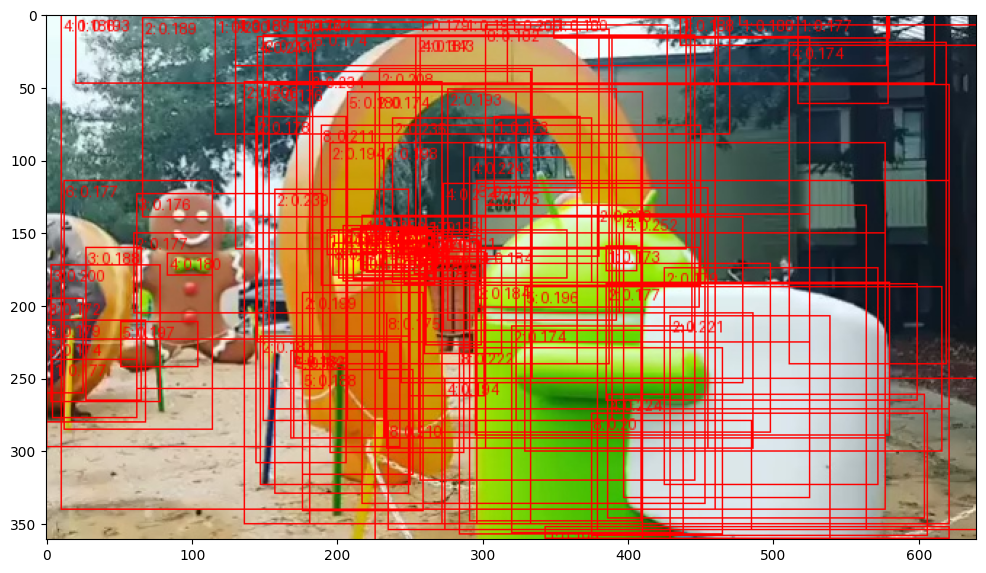

begin fine-tuning
Epoch: 0, Loss: 2.3651585578918457
Epoch: 0, Loss: 2.2827341556549072
Epoch: 0, Loss: 2.391106128692627
Epoch: 0, Loss: 1.6730767488479614
Epoch: 0, Loss: 1.0650928020477295
Epoch: 0, Train loss: 1.9554336786270141, Val loss: 1.3258742094039917
Epoch: 1, Loss: 0.8456634283065796
Epoch: 1, Loss: 1.076192021369934
Epoch: 1, Loss: 1.6172868013381958
Epoch: 1, Loss: 1.087672472000122
Epoch: 1, Loss: 0.6793662905693054
Epoch: 1, Train loss: 1.0612362027168274, Val loss: 1.0567784309387207
Epoch: 2, Loss: 0.5100059509277344
Epoch: 2, Loss: 0.9348393678665161
Epoch: 2, Loss: 1.6551963090896606
Epoch: 2, Loss: 0.8873373866081238
Epoch: 2, Loss: 0.5640988349914551
Epoch: 2, Train loss: 0.910295569896698, Val loss: 1.070523977279663
Epoch: 3, Loss: 0.3785451650619507
Epoch: 3, Loss: 0.824734628200531
Epoch: 3, Loss: 1.4094223976135254
Epoch: 3, Loss: 0.790969729423523
Epoch: 3, Loss: 0.4837307929992676
Epoch: 3, Train loss: 0.7774805426597595, Val loss: 1.0071151852607727
Epoch

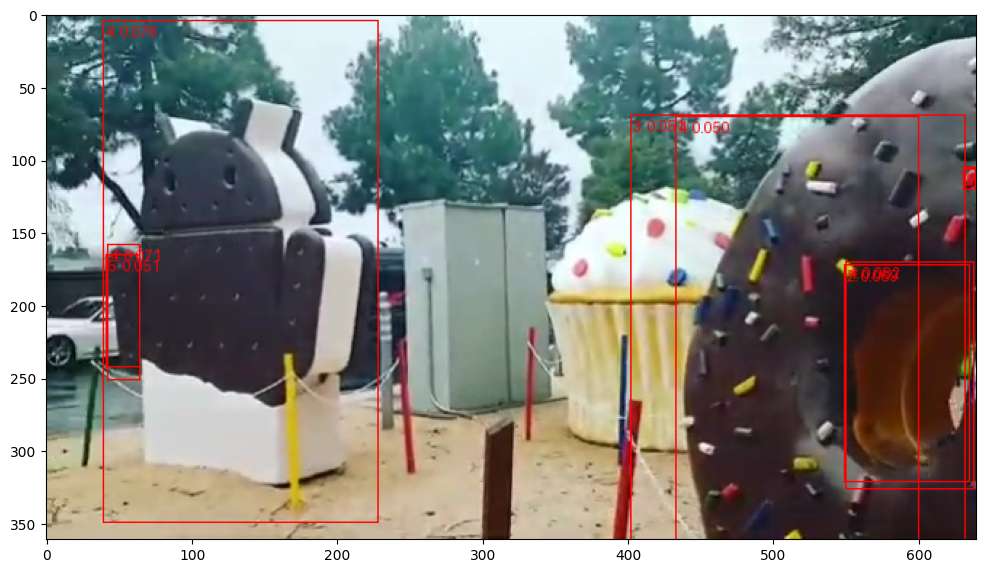

labels[0]=['4: 0.082', '4: 0.076', '4: 0.071', '2: 0.069', '2: 0.057', '4: 0.057', '3: 0.051', '5: 0.051', '4: 0.050']


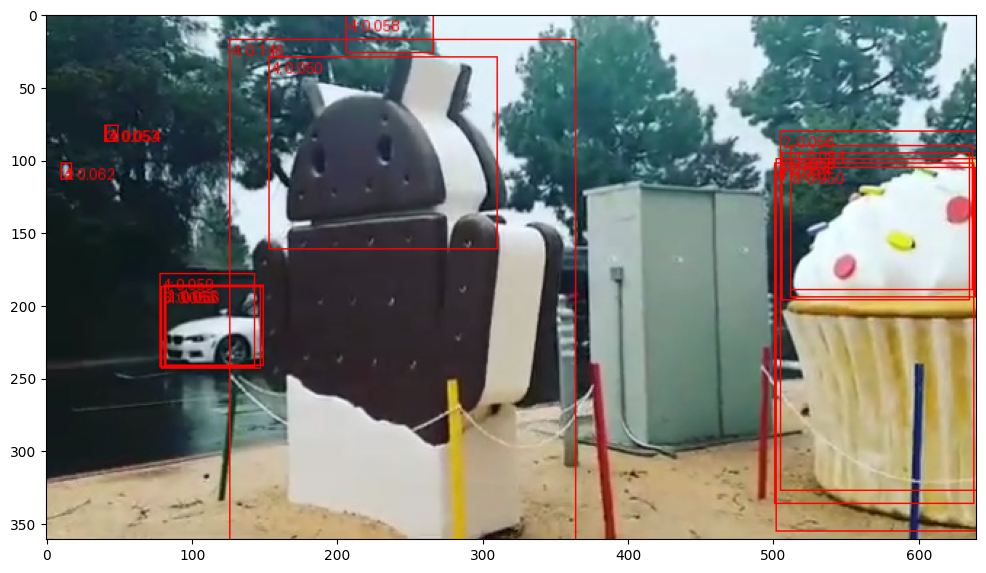

labels[1]=['4: 0.146', '4: 0.092', '4: 0.084', '4: 0.062', '4: 0.059', '2: 0.059', '4: 0.058', '2: 0.056', '1: 0.056', '3: 0.055', '2: 0.055', '3: 0.054', '4: 0.054', '3: 0.053', '3: 0.050', '4: 0.050']


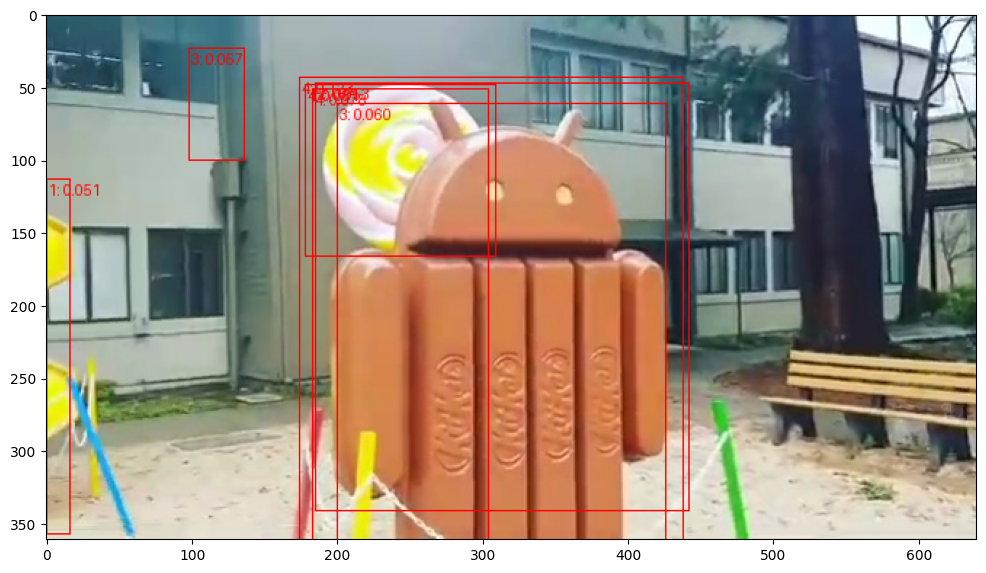

labels[2]=['4: 0.123', '4: 0.081', '4: 0.078', '3: 0.060', '3: 0.057', '2: 0.053', '1: 0.051']


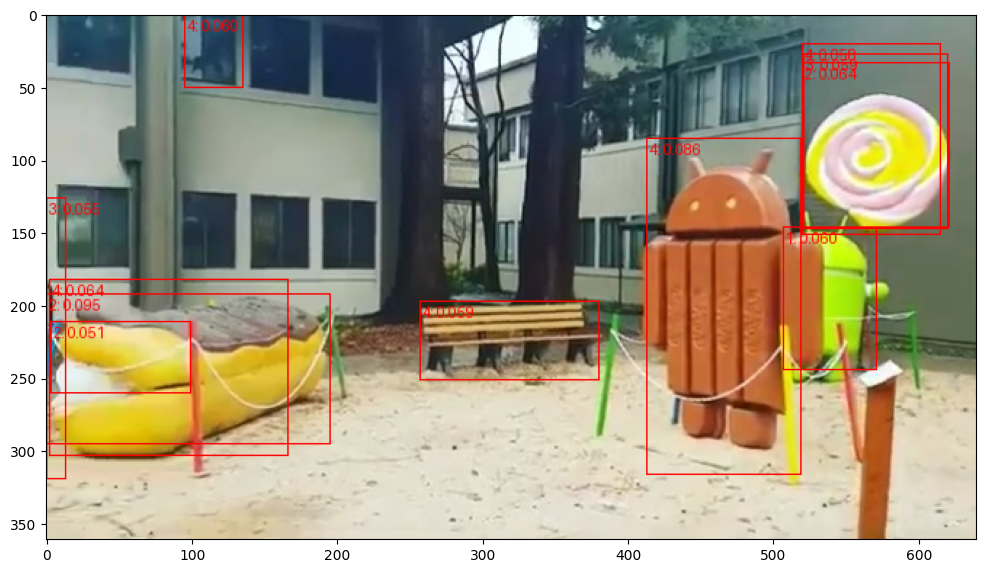

labels[3]=['2: 0.095', '4: 0.086', '2: 0.064', '4: 0.064', '1: 0.060', '4: 0.060', '3: 0.059', '4: 0.059', '4: 0.058', '3: 0.055', '2: 0.051']


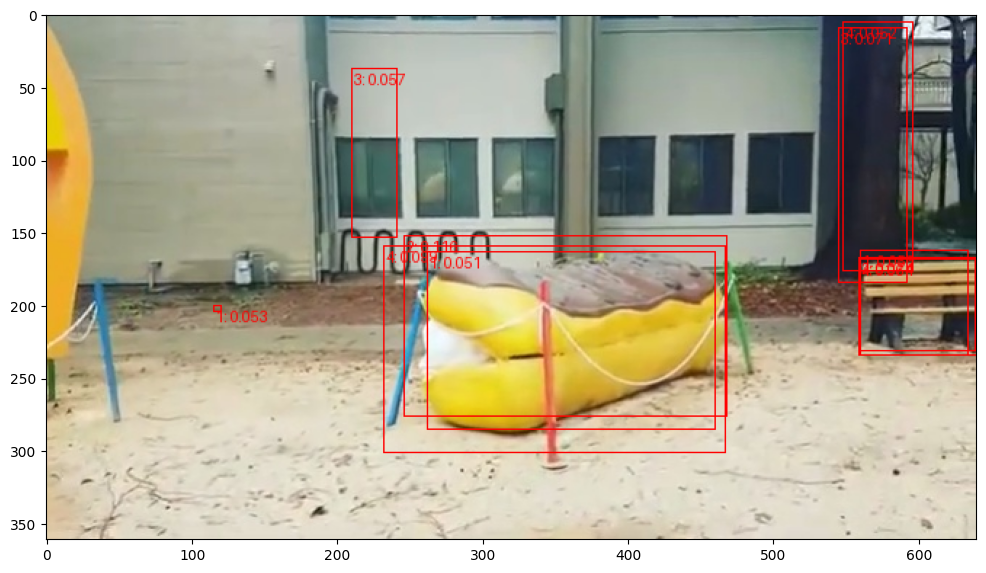

labels[4]=['2: 0.116', '4: 0.099', '2: 0.074', '3: 0.071', '4: 0.064', '3: 0.057', '1: 0.056', '1: 0.053', '4: 0.052', '1: 0.051']


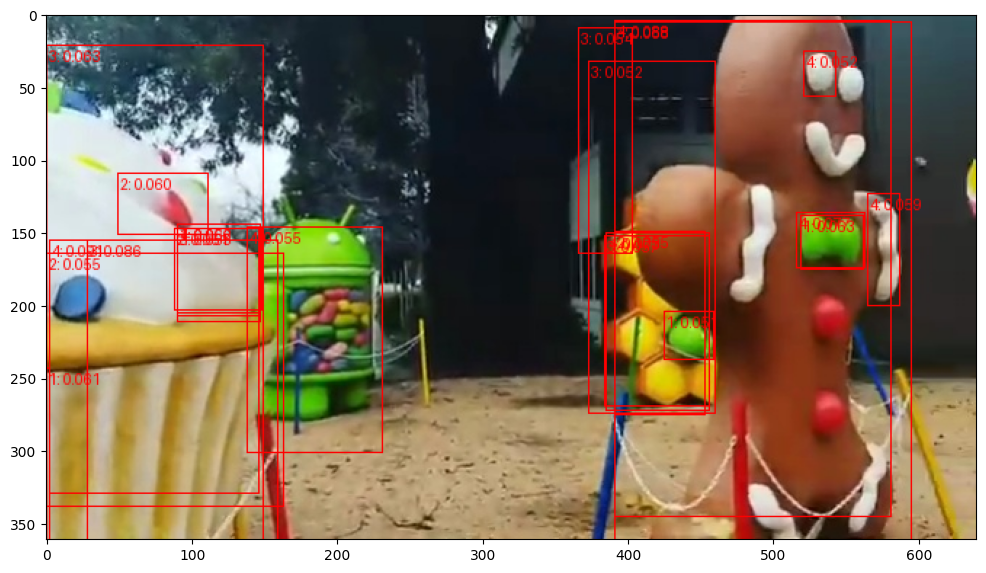

labels[5]=['4: 0.091', '4: 0.088', '3: 0.086', '4: 0.077', '4: 0.073', '4: 0.066', '1: 0.063', '3: 0.063', '1: 0.061', '2: 0.060', '4: 0.059', '3: 0.058', '3: 0.057', '3: 0.055', '2: 0.055', '2: 0.055', '4: 0.055', '3: 0.054', '3: 0.052', '4: 0.052', '1: 0.052', '2: 0.051', '1: 0.051']


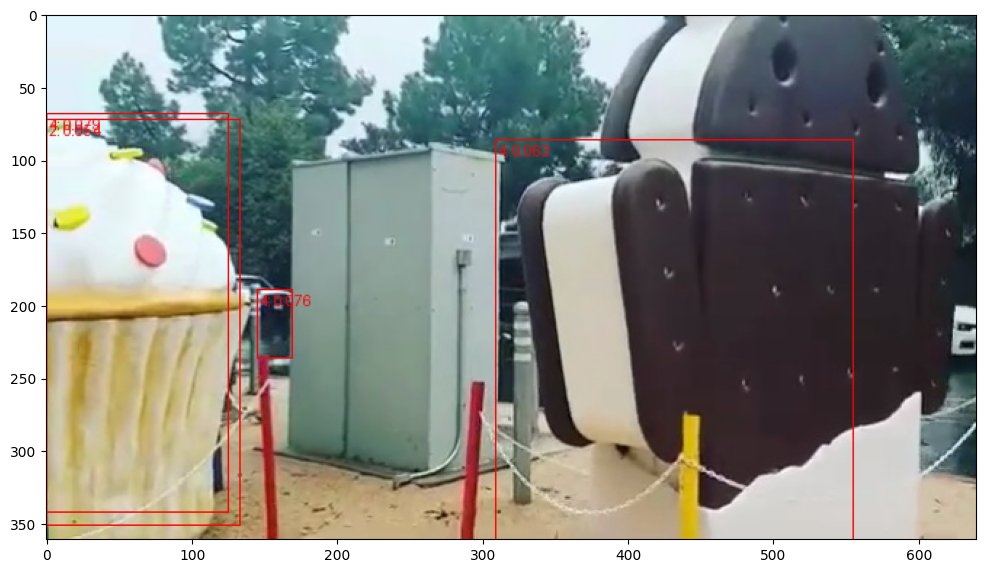

labels[6]=['4: 0.079', '4: 0.076', '4: 0.063', '2: 0.054']


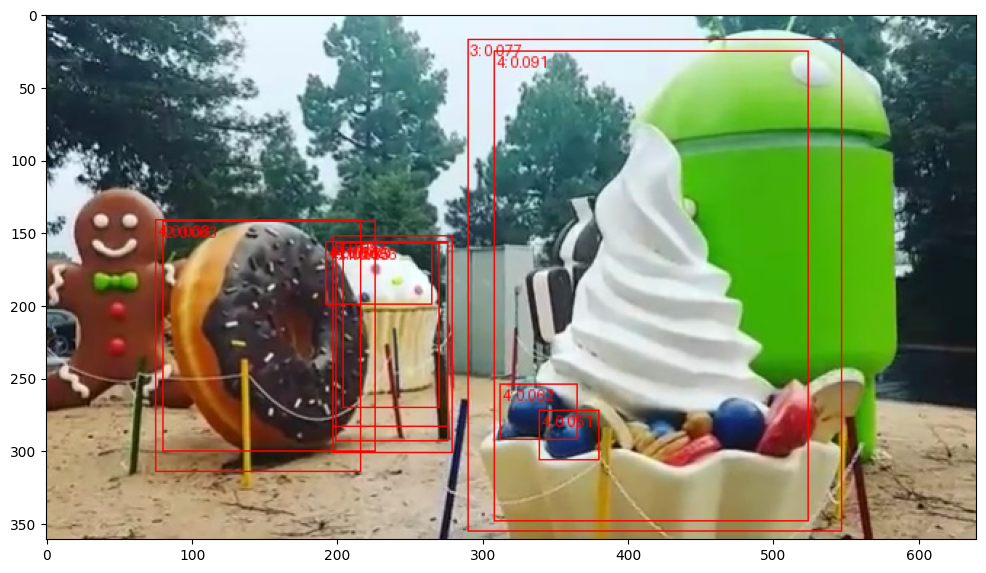

labels[7]=['4: 0.091', '3: 0.077', '4: 0.068', '2: 0.063', '4: 0.062', '4: 0.059', '3: 0.057', '1: 0.056', '2: 0.053', '4: 0.051', '4: 0.051']


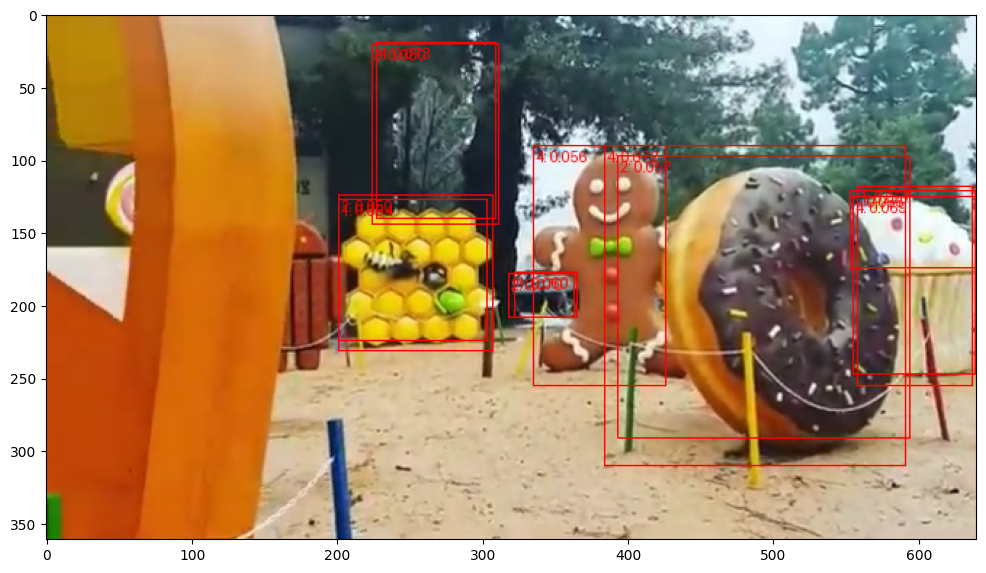

labels[8]=['3: 0.080', '4: 0.073', '4: 0.072', '2: 0.070', '4: 0.069', '1: 0.060', '2: 0.057', '1: 0.057', '4: 0.056', '1: 0.055', '1: 0.054', '2: 0.050']


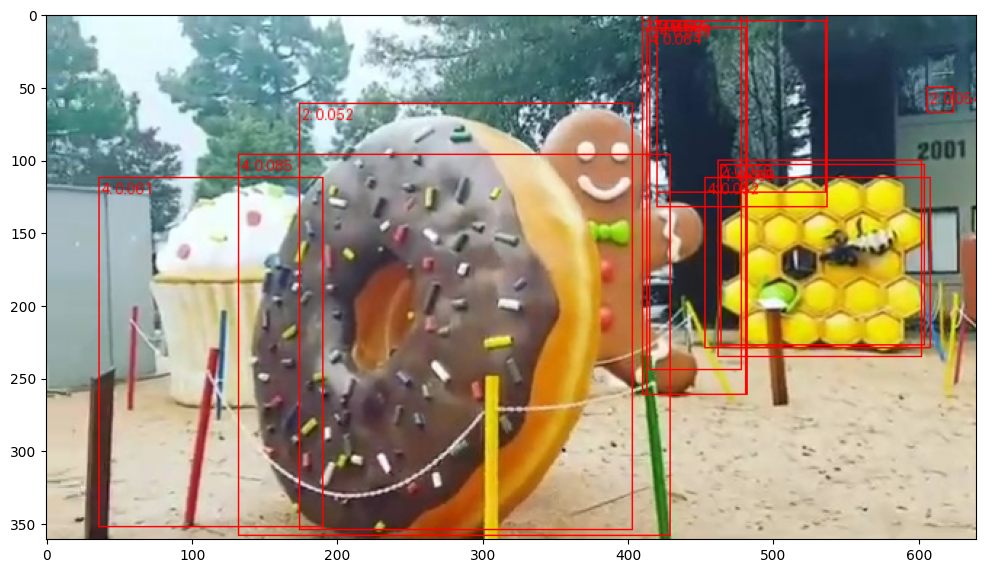

labels[9]=['3: 0.095', '4: 0.085', '1: 0.069', '3: 0.064', '4: 0.064', '4: 0.061', '4: 0.059', '2: 0.058', '2: 0.054', '2: 0.053', '4: 0.052', '2: 0.052']


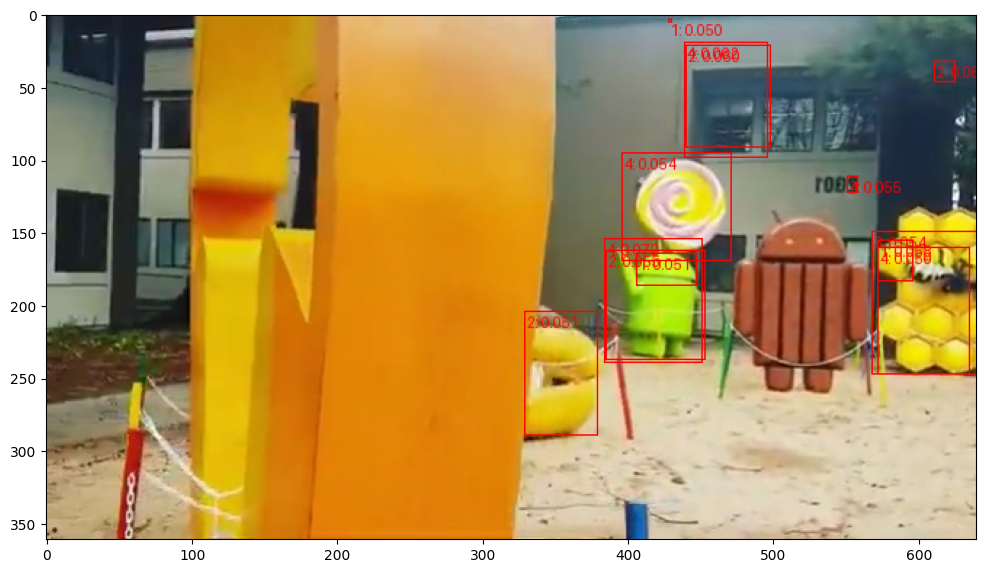

labels[10]=['4: 0.072', '4: 0.062', '2: 0.061', '2: 0.060', '1: 0.058', '2: 0.055', '4: 0.055', '4: 0.054', '3: 0.054', '2: 0.051', '1: 0.051', '1: 0.050', '4: 0.050']


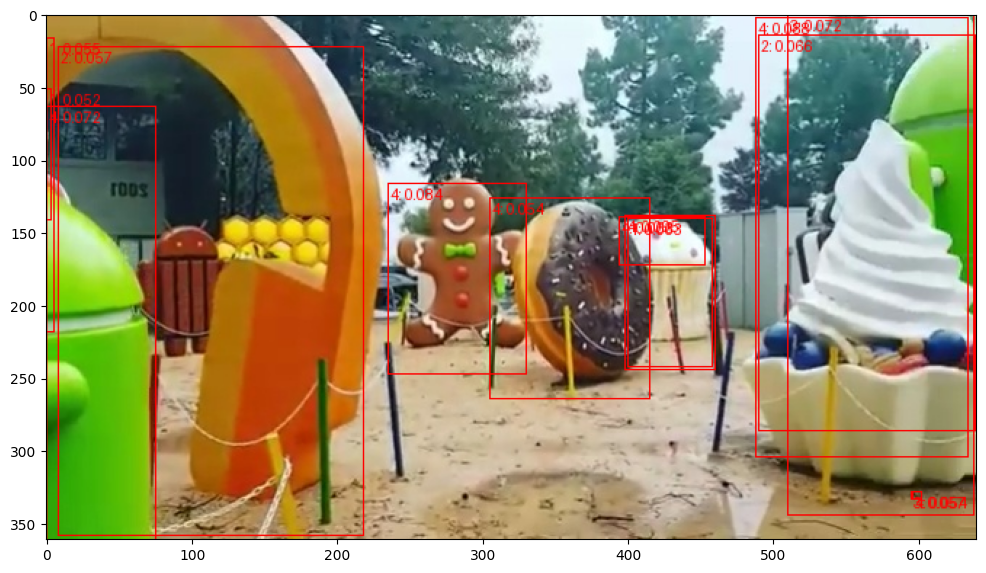

labels[11]=['4: 0.095', '4: 0.088', '4: 0.084', '3: 0.072', '4: 0.072', '2: 0.066', '1: 0.063', '3: 0.057', '2: 0.057', '1: 0.055', '4: 0.054', '4: 0.054', '4: 0.053', '1: 0.052']


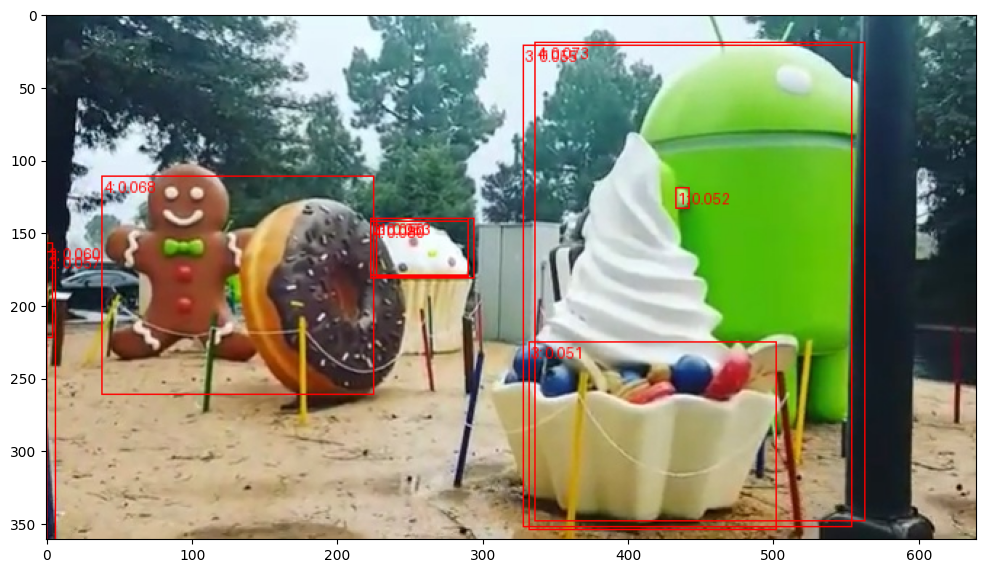

labels[12]=['4: 0.080', '4: 0.073', '4: 0.068', '2: 0.060', '2: 0.057', '3: 0.055', '1: 0.053', '1: 0.052', '3: 0.051', '3: 0.050']


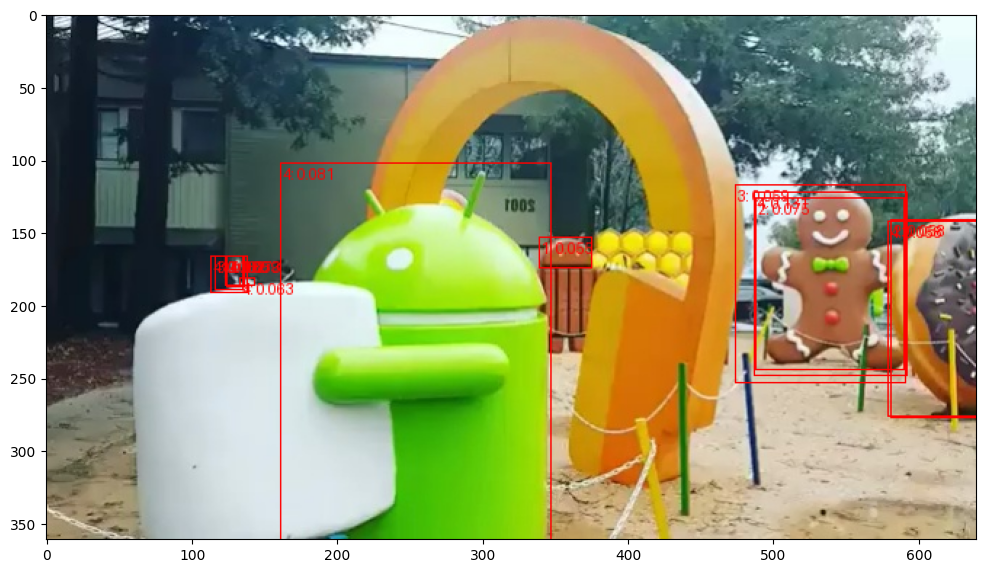

labels[13]=['4: 0.131', '4: 0.081', '3: 0.080', '2: 0.075', '4: 0.073', '4: 0.063', '4: 0.062', '3: 0.059', '2: 0.059', '4: 0.058', '2: 0.058', '1: 0.055']


In [6]:
transforms = load_pytorch_models.get_transform(train=True)

# check test results w/o training
%matplotlib inline
print('run pre-trained model on test data')
model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction[0]["labels"], prediction[0]["scores"])]
            pred_boxes = prediction[0]["boxes"].long()
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            print(f'labels[{j}]={pred_labels}')
            plt.show()
        j+=1

print('begin fine-tuning')

learning_rate = 0.001
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.Adam(params, lr=learning_rate)

early_stopping = load_pytorch_models.EarlyStopping(patience=2, delta=0.01, verbose=True)

epochs = 5

for epoch in range(epochs):
    train_loss = 0.0
    val_loss = 0.0
    model.train()
    for images, targets in data_loader_train:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
    
        # Forward pass
        loss_dict = model(images, targets)
        #loss_dict={'loss_classifier': tensor(1.4729, grad_fn=<NllLossBackward0>), 
        #'loss_box_reg': tensor(0.2687, grad_fn=<DivBackward0>), 
        #'loss_objectness': tensor(0.0328), 
        #'loss_rpn_box_reg': tensor(0.0035)}
        losses = sum(loss for loss in loss_dict.values())
        
        train_loss += losses.item()
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backward pass
        losses.backward()

        # Update model parameters
        optimizer.step()

        # Print or log training progress
        print(f"Epoch: {epoch}, Loss: {losses.item()}")

    train_loss /= len(data_loader_train)
    
    #validation
    # for fastcnn, there are no dropout layers, but there are BatchNormalizatiion layers which
    # would affect the loss, BUT the model uses FrozenBatchNorm layers do not update running stats, 
    # so train() mode won't corrupt your validation loss.
    # leave the model in train mode to get the calculated losses for validation dataset
    with torch.no_grad():
        for images, targets in data_loader_val:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            loss_dict = model(images, targets)
            #print(f'**loss_dict={loss_dict}')
            losses = sum(loss for loss in loss_dict.values())
            val_loss += losses.item()

    val_loss /= len(data_loader_val)
    
    print(f"Epoch: {epoch}, Train loss: {train_loss}, Val loss: {val_loss}")
    
    early_stopping.check_early_stop(val_loss)
    if early_stopping.stop_training:
        print(f"Early stopping at epoch {epoch}")
        break
    
print('evalulate fine-tuned model on test data')

model.eval()
with torch.no_grad():
    j = 0
    for filepath in filepaths:
        image = tv_tensors.Image(read_image(filepath))
        image = transforms(image)
        images = [image.to(device)]
        # Forward pass
        prediction = model(images)
        prediction = prediction[0]
        outimg = os.path.join(module_dir, f"output_{j}.png")
        outfile = os.path.join(module_dir, f"output_{j}.txt")
        for img in images:
            image = (255.0 * (img - img.min()) / (img.max() - img.min())).to(torch.uint8)
            image = image[:3, ...]
            pred_labels = [f"{label}: {score:.3f}" for label, score in zip(prediction["labels"], prediction["scores"])]
            pred_boxes = prediction["boxes"].long()
            output_image = draw_bounding_boxes(image, pred_boxes, pred_labels, colors="red")
            plt.figure(figsize=(12, 12))
            plt.imshow(output_image.permute(1, 2, 0))
            plt.savefig(outimg)
            plt.show()
            print(f'labels[{j}]={pred_labels}')
            lines = []
            for k in range(len(prediction["labels"])):
                _label = prediction["labels"][k].item()
                _cat = category_index[_label]["name"]
                _score = prediction["scores"][k].item()
                _boxes = prediction["boxes"][k].tolist()
                lines.append((_cat, _score, _boxes[0], _boxes[1], _boxes[2], _boxes[3]))
            sorted_lines = sorted(lines, key=lambda x: (x[2], x[3], x[4], x[5]))
            with open(outfile, "w") as file:
                for line in sorted_lines:
                    file.write(f"{line[0]},{line[1]:.3f},{line[2]:.3f},{line[3]:.3f},{line[4]:.3f},{line[5]:.3f}\n")
        j+=1


In [8]:
#save model, load saved model, and compare results

params={'num_classes_custom' : num_classes_custom}
model_name = 'fasterrcnn_20250801_1'
model_dir = module_dir

load_pytorch_models.save(model, params, model_dir, model_name)

model2, params2 = load_pytorch_models.load_model(model_dir, model_name, device)

sample_image, sample_target = next(iter(data_loader_val))
_images1 = list(image for image in sample_image)
_targets1 = [{k: v for k, v in t.items()} for t in sample_target]
output1 = model(_images1, _targets1)
output2 = model2(_images1, _targets1)

#TODO: match the boxes, then compare the labels and scores.  a quick browse shows out1 and output2 similar


in_features=1024
